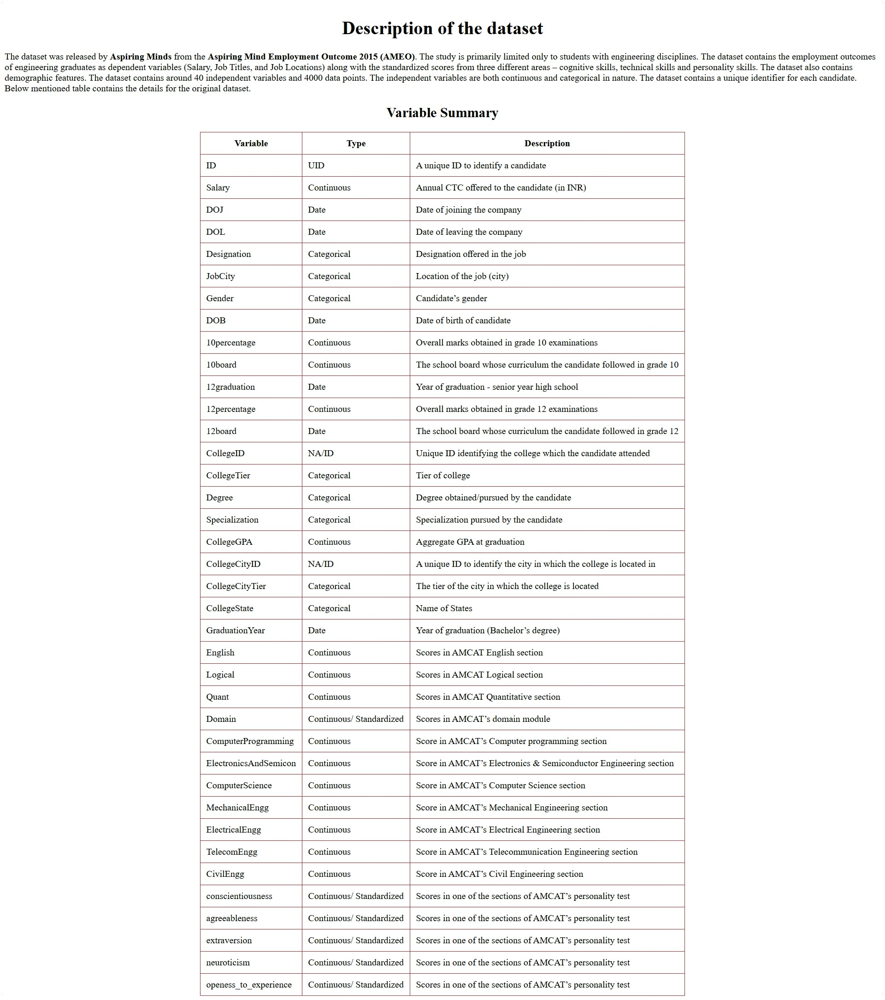

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from scipy.stats import kurtosis,skew
import warnings
warnings.filterwarnings("ignore")


In [2]:
import pandas as pd
df=pd.read_excel('C:\\Users\\nEW u\\Desktop\\innomatics\\task_10\\aspiring_minds_employability_outcomes_2015.xlsx', engine='openpyxl')
df.head()

,Unnamed: 0,ID,Salary,DOJ,DOL,Designation,JobCity,Gender,DOB,10percentage,...,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
0,train,203097,420000,2012-06-01,present,senior quality engineer,Bangalore,f,1990-02-19,84.3,...,-1,-1,-1,-1,-1,0.9737,0.8128,0.5269,1.35490,-0.4455
1,train,579905,500000,2013-09-01,present,assistant manager,Indore,m,1989-10-04,85.4,...,-1,-1,-1,-1,-1,-0.7335,0.3789,1.2396,-0.10760,0.8637
2,train,810601,325000,2014-06-01,present,systems engineer,Chennai,f,1992-08-03,85.0,...,-1,-1,-1,-1,-1,0.2718,1.7109,0.1637,-0.86820,0.6721
3,train,267447,1100000,2011-07-01,present,senior software engineer,Gurgaon,m,1989-12-05,85.6,...,-1,-1,-1,-1,-1,0.0464,0.3448,-0.3440,-0.40780,-0.9194
4,train,343523,200000,2014-03-01,2015-03-01 00:00:00,get,Manesar,m,1991-02-27,78.0,...,-1,-1,-1,-1,-1,-0.8810,-0.2793,-1.0697,0.09163,-0.1295


In [3]:
#dropping the unnecessary columns
df.drop(['Unnamed: 0','ID','CollegeID','CollegeCityID'], axis=1, inplace=True)

In [4]:
df.describe()

,Salary,10percentage,12graduation,12percentage,CollegeTier,collegeGPA,CollegeCityTier,GraduationYear,English,Logical,...,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
count,3.998000e+03,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,...,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000
mean,3.076998e+05,77.925443,2008.087544,74.466366,1.925713,71.486171,0.300400,2012.105803,501.649075,501.598799,...,90.742371,22.974737,16.478739,31.851176,2.683842,-0.037831,0.146496,0.002763,-0.169033,-0.138110
std,2.127375e+05,9.850162,1.653599,10.999933,0.262270,8.167338,0.458489,31.857271,104.940021,86.783297,...,175.273083,98.123311,87.585634,104.852845,36.658505,1.028666,0.941782,0.951471,1.007580,1.008075
min,3.500000e+04,43.000000,1995.000000,40.000000,1.000000,6.450000,0.000000,0.000000,180.000000,195.000000,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-4.126700,-5.781600,-4.600900,-2.643000,-7.375700
25%,1.800000e+05,71.680000,2007.000000,66.000000,2.000000,66.407500,0.000000,2012.000000,425.000000,445.000000,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-0.713525,-0.287100,-0.604800,-0.868200,-0.669200
50%,3.000000e+05,79.150000,2008.000000,74.400000,2.000000,71.720000,0.000000,2013.000000,500.000000,505.000000,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,0.046400,0.212400,0.091400,-0.234400,-0.094300
75%,3.700000e+05,85.670000,2009.000000,82.600000,2.000000,76.327500,1.000000,2014.000000,570.000000,565.000000,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,0.702700,0.812800,0.672000,0.526200,0.502400
max,4.000000e+06,97.760000,2013.000000,98.700000,2.000000,99.930000,1.000000,2017.000000,875.000000,795.000000,...,715.000000,623.000000,676.000000,548.000000,516.000000,1.995300,1.904800,2.535400,3.352500,1.822400


<h1>Observation:</h1>
<h4>There is lot of imbalance in the dataset as we can observe:</h4>
<p>
        <div>a. The scales of collegeGPA are different.</div>
        <div>b. There is some right skewness is salary distribution as there is difference between mean and median of salary.</div>
        <div>c. Columns like ID, collegeID,collegeTier,collegeCityID,CollegeCityTier doestn't making any sense to measure them.</div>
        <div>d. lots of impurity in some columns i.e they contain (nan,-1) values.</div>
</p>

In [5]:
df.columns

Index(['Salary', 'DOJ', 'DOL', 'Designation', 'JobCity', 'Gender', 'DOB',
       '10percentage', '10board', '12graduation', '12percentage', '12board',
       'CollegeTier', 'Degree', 'Specialization', 'collegeGPA',
       'CollegeCityTier', 'CollegeState', 'GraduationYear', 'English',
       'Logical', 'Quant', 'Domain', 'ComputerProgramming',
       'ElectronicsAndSemicon', 'ComputerScience', 'MechanicalEngg',
       'ElectricalEngg', 'TelecomEngg', 'CivilEngg', 'conscientiousness',
       'agreeableness', 'extraversion', 'nueroticism',
       'openess_to_experience'],
      dtype='object')

<p>
<h4>Independent Features:</h4>
<div>[ID, Gender, DOB, 10percentage, 10board, 12graduation,12percentage, 12board, CollegeID, CollegeTier, Degree,Specialization, collegeGPA, CollegeCityID, CollegeCityTier,CollegeState, GraduationYear, English, Logical, Quant, Domain, ComputerProgramming, ElectronicsAndSemicon,ComputerScience, MechanicalEngg, ElectricalEngg, TelecomEngg,CivilEngg, conscientiousness, agreeableness, extraversion, nueroticism, openess_to_experience]</div>
<h4>Dependent Features:</h4>
<div>[Salary, Job Titles, and Job Locations]</div>
</p>

In [6]:
df['DOL']=df['DOL'].str.replace('present','01-12-2015 00:00')
df['DOL'] = pd.to_datetime(df['DOL'])
df['DOJ'] = pd.to_datetime(df['DOJ'])
df['DOB'] = pd.to_datetime(df['DOB'])
df['EXP']=df['DOL']-df['DOJ']

In [7]:
df['EXP'][:4]

0    955 days
1    498 days
2    225 days
3   1291 days
Name: EXP, dtype: timedelta64[ns]

In [8]:
df['Age']=df['DOL']-df['DOB']
df['Age']=df['Age'].astype(str)

In [9]:
df['Experience']=((df['DOL']-df['DOJ']).map(lambda x: round(x.days/365,1)))

In [10]:
df['Experience'][:4]

0    2.6
1    1.4
2    0.6
3    3.5
Name: Experience, dtype: float64

In [11]:
df.loc[df['collegeGPA']<=10,'collegeGPA']*=9.5

In [12]:
df['collegeGPA'][:5]

0    78.00
1    70.06
2    70.00
3    74.64
4    73.90
Name: collegeGPA, dtype: float64

In [13]:
print(f'The number of unique element present in JobCity is : {df.JobCity.nunique()}')
print('\n')
print(f'The unique element present in JobCity is : \n  {df.JobCity.unique()}')


The number of unique element present in JobCity is : 339


The unique element present in JobCity is : 
  ['Bangalore' 'Indore' 'Chennai' 'Gurgaon' 'Manesar' 'Hyderabad' 'Banglore'
 'Noida' 'Kolkata' 'Pune' -1 'mohali' 'Jhansi' 'Delhi' 'Hyderabad '
 'Bangalore ' 'noida' 'delhi' 'Bhubaneswar' 'Navi Mumbai' 'Mumbai'
 'New Delhi' 'Mangalore' 'Rewari' 'Gaziabaad' 'Bhiwadi' 'Mysore' 'Rajkot'
 'Greater Noida' 'Jaipur' 'noida ' 'HYDERABAD' 'mysore' 'THANE'
 'Maharajganj' 'Thiruvananthapuram' 'Punchkula' 'Bhubaneshwar' 'Pune '
 'coimbatore' 'Dhanbad' 'Lucknow' 'Trivandrum' 'kolkata' 'mumbai'
 'Gandhi Nagar' 'Una' 'Daman and Diu' 'chennai' 'GURGOAN' 'vsakhapttnam'
 'pune' 'Nagpur' 'Bhagalpur' 'new delhi - jaisalmer' 'Coimbatore'
 'Ahmedabad' 'Kochi/Cochin' 'Bankura' 'Bengaluru' 'Mysore ' 'Kanpur '
 'jaipur' 'Gurgaon ' 'bangalore' 'CHENNAI' 'Vijayawada' 'Kochi' 'Beawar'
 'Alwar' 'NOIDA' 'Greater noida' 'Siliguri ' 'raipur' 'gurgaon' 'Bhopal'
 'Faridabad' 'Jodhpur' 'udaipur' 'Muzaffarpur' 'Kolkata

<p>
<h4>Observation:</h4>
<div>From the column JobCity we can see that there are many annomaly present</div>
<div>For Example:</div>
<div><strong>[bangalore,BAngalore,Banglore,BANGLORE, bangalore,banagalore]</strong> all are <strong>bangalore</strong> bt writtten in different way and all these are taken as unique features.</div>
<div>Therefore we need to clear all these.</div>
</p>

The number of unique element present in Specialization is : 46


The unique element present in Specialization is : 
  ['computer engineering' 'electronics and communication engineering'
 'information technology' 'computer science & engineering'
 'mechanical engineering' 'electronics and electrical engineering'
 'electronics & telecommunications'
 'instrumentation and control engineering' 'computer application'
 'electronics and computer engineering' 'electrical engineering'
 'applied electronics and instrumentation'
 'electronics & instrumentation eng' 'information science engineering'
 'civil engineering' 'mechanical and automation'
 'industrial & production engineering'
 'control and instrumentation engineering' 'metallurgical engineering'
 'electronics and instrumentation engineering' 'electronics engineering'
 'ceramic engineering' 'chemical engineering' 'aeronautical engineering'
 'other' 'biotechnology' 'embedded systems technology'
 'electrical and power engineering' 'computer s

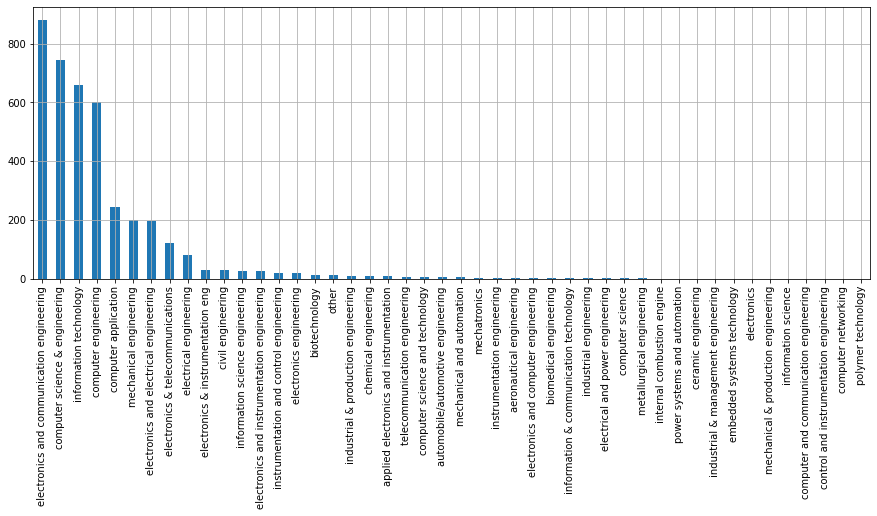

In [14]:
print(f'The number of unique element present in Specialization is : {df.Specialization.nunique()}')
print('\n')
print(f'The unique element present in Specialization is : \n  {df.Specialization.unique()}')

print("Number of unique Specialization :",df['Specialization'].nunique())
print('\n')
print(df['Specialization'].value_counts())
print('\n')
specialization_freq = df['Specialization'].value_counts()
specialization_freq.plot(kind = 'bar', figsize = (15, 5),grid = True)
plt.show()

<p>
<h4>Observation:</h4>
<div>There are 46 specialization classes but the names of some classes seems similar and some of them have very few records</div>
<div>so we are making groups of similar specialization classes and put some of them in other specialization as they have very few records.</div>
<h4>Group names: </h4>
<div>EC = Electronic and Communication</div>
<div>CS = Computer Science</div>
<div>other = All other specializations</div>
</p>

The unique element present in the Specilaation :  ['CS' 'EC' 'other']

The count of each element : 
  CS       2289
EC       1319
other     390
Name: Specialization, dtype: int64


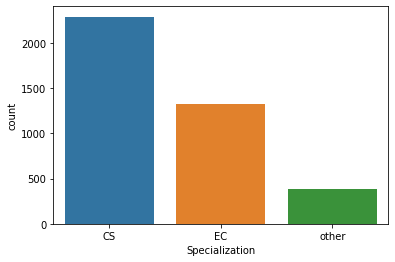

In [15]:
specialization_group =\
{'electronics and communication engineering' : 'EC',
 'computer science & engineering' : 'CS',
 'information technology' : 'CS' ,
 'computer engineering' : 'CS',
 'computer application' : 'CS',
 'mechanical engineering' : 'other',
 'electronics and electrical engineering' : 'EC',
 'electronics & telecommunications' : 'EC',
 'electrical engineering' : 'other',
 'electronics & instrumentation eng' : 'EC',
 'civil engineering' : 'other',
 'electronics and instrumentation engineering' : 'EC',
 'information science engineering' : 'CS',
 'instrumentation and control engineering' : 'EC',
 'electronics engineering' : 'EC',
 'biotechnology' : 'other',
 'other' : 'other',
 'industrial & production engineering' : 'other',
 'chemical engineering' : 'other',
 'applied electronics and instrumentation' : 'EC',
 'computer science and technology' : 'CS',
 'telecommunication engineering' : 'EC',
 'mechanical and automation' : 'other',
 'automobile/automotive engineering' : 'other',
 'instrumentation engineering' : 'EC',
 'mechatronics' : 'other',
 'electronics and computer engineering' : 'CS',
 'aeronautical engineering' : 'other',
 'computer science' : 'CS',
 'metallurgical engineering' : 'other',
 'biomedical engineering' : 'other',
 'industrial engineering' : 'other',
 'information & communication technology' : 'EC',
 'electrical and power engineering' : 'other',
 'industrial & management engineering' : 'other',
 'computer networking' : 'CS',
 'embedded systems technology' : 'EC',
 'power systems and automation' : 'other',
 'computer and communication engineering' : 'CS',
 'information science' : 'CS',
 'internal combustion engine' : 'other',
 'ceramic engineering' : 'other',
 'mechanical & production engineering' : 'other',
 'control and instrumentation engineering' : 'EC',
 'polymer technology' : 'other',
 'electronics' : 'EC'}

 
df['Specialization'] = df['Specialization'].map(specialization_group)

print('The unique element present in the Specilaation : ', str(df['Specialization'].unique()))
print()
print('The count of each element : \n ', str(df['Specialization'].value_counts()))
sns.countplot(df['Specialization'])

plt.show()



In [16]:
df.Specialization.unique()


array(['CS', 'EC', 'other'], dtype=object)

In [17]:
print(f'The number of unique element present in Designation is : {df.Designation.nunique()}')
print('\n')
print(f'The unique element present in Designation is : \n  {df.Designation.unique()}')

The number of unique element present in Designation is : 419


The unique element present in Designation is : 
  ['senior quality engineer' 'assistant manager' 'systems engineer'
 'senior software engineer' 'get' 'system engineer'
 'java software engineer' 'mechanical engineer' 'electrical engineer'
 'project engineer' 'senior php developer' 'senior systems engineer'
 'quality assurance engineer' 'qa analyst' 'network engineer'
 'product development engineer' 'associate software developer'
 'data entry operator' 'software engineer' 'developer'
 'electrical project engineer' 'programmer analyst' 'systems analyst'
 'ase' 'telecommunication engineer' 'application developer'
 'ios developer' 'executive assistant' 'online marketing manager'
 'documentation specialist' 'associate software engineer'
 'management trainee' 'site manager' 'software developer' '.net developer'
 'production engineer' 'jr. software engineer'
 'trainee software developer' 'ui developer' 'assistant system engineer'
 

In [18]:
l=[]
for i in df['Designation']:
    if ('senior' in i and 'engineer' not in i):
        l.append('senior')
    elif('trainee'in i and 'engineer' not in i):
        l.append('trainee')
    elif('engineer' in i and 'senior' not in i):
        l.append('engineer')
    elif('associate' in i and 'senior' not in i):
        l.append('associate')
    elif('developer' in i and 'senior' not in i):
        l.append('developer')
    elif('manager' in i and 'senior' not in i):
        l.append('manager')
    elif('analyst' in i):
        l.append('analyst')
    elif('consultant' in i):
        l.append('consultant')
    elif('executive' in i):
        l.append('executive')
    elif('designer' in i):
        l.append('designer')
    else:
        l.append('others')

engineer      1997
developer      668
others         538
analyst        402
manager        123
associate       66
executive       62
trainee         57
senior          43
designer        23
consultant      19
Name: Designations, dtype: int64



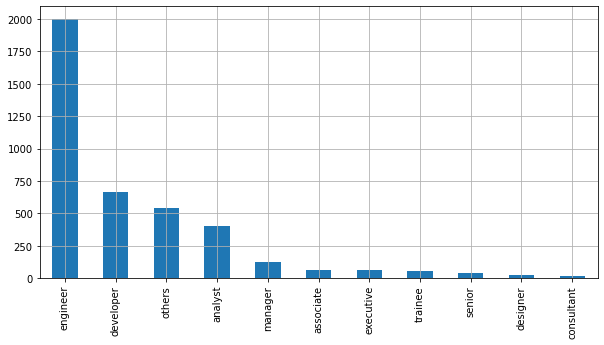

In [19]:
df['Designations']=l
plt.figure(figsize=(10,5))
print(df['Designations'].value_counts())
print()
df['Designations'].value_counts().plot(kind='bar', grid=True)
plt.show()



In [20]:
df['English']=((df['English']*100)/875)
df['Quant']=((df['Quant']*100)/900)
df['Logical']=((df['Logical']*100)/795)

In [21]:
train1=df['English']+df['Quant']+df['Logical']
df['Cognitive Test Scores']=train1/3

In [22]:
df['Cognitive Test Scores'][:5]

0    63.591794
1    80.941599
2    59.983428
3    71.866926
4    64.189578
Name: Cognitive Test Scores, dtype: float64

In [23]:
df['12board'].replace(to_replace = 0, value = 'cbse', inplace = True)

In [24]:
print(df['12board'].value_counts())

cbse                       1759
state board                1254
icse                        129
up board                     87
isc                          45
                           ... 
p u board, karnataka          1
higher secondary              1
kolhapur                      1
uttaranchal state board       1
mp board bhopal               1
Name: 12board, Length: 339, dtype: int64


In [25]:
state_board_list=['board of intermediate education,ap', 'state board',
       'mp board',  'karnataka pre university board', 'up',
       'p u board, karnataka', 'dept of pre-university education', 'bie',
       'kerala state hse board', 'up board', 'bseb', 'chse', 'puc',
       ' upboard',
       'state  board of intermediate education, andhra pradesh',
       'karnataka state board',
       'west bengal state council of technical education', 'wbchse',
       'maharashtra state board', 'ssc',
       'sda matric higher secondary school', 'uttar pradesh board', 'ibe',
       'chsc', 'board of intermediate', 'upboard', 'sbtet',
       'hisher seconadry examination(state board)', 'pre university',
       'borad of intermediate', 'j & k board',
       'intermediate board of andhra pardesh', 'rbse',
       'central board of secondary education', 'jkbose', 'hbse',
       'board of intermediate education', 'state', 'ms board', 'pue',
       'intermediate state board', 'stateboard', 'hsc',
       'electonincs and communication(dote)', 'karnataka pu board',
       'government polytechnic mumbai , mumbai board', 'pu board',
       'baord of intermediate education', 'apbie', 'andhra board',
       'tamilnadu stateboard',
       'west bengal council of higher secondary education',
       'cbse,new delhi', 'u p board', 'intermediate', 'biec,patna',
       'diploma in engg (e &tc) tilak maharashtra vidayapeeth',
       'hsc pune', 'pu board karnataka', 'kerala', 'gsheb',
       'up(allahabad)', 'nagpur', 'st joseph hr sec school',
       'pre university board', 'ipe', 'maharashtra', 'kea', 'apsb',
       'himachal pradesh board of school education', 'staae board',
       'international baccalaureate (ib) diploma', 'nios',
       'karnataka board of university',
       'board of secondary education rajasthan', 'uttarakhand board',
       'ua', 'scte vt orissa', 'matriculation',
       'department of pre-university education', 'wbscte',
       'preuniversity board(karnataka)', 'jharkhand accademic council',
       'bieap', 'msbte (diploma in computer technology)',
       'jharkhand acamedic council (ranchi)',
       'department of pre-university eduction', 'biec',
       'sjrcw', ' board of intermediate', 'msbte',
       'sri sankara vidyalaya', 'chse, odisha', 'bihar board',
       'maharashtra state(latur board)', 'rajasthan board', 'mpboard',
       'state board of technical eduction panchkula', 'upbhsie', 'apbsc',
       'state board of technical education and training',
       'secondary board of rajasthan',
       'tamilnadu higher secondary education board',
       'jharkhand academic council',
       'board of intermediate education,hyderabad', 'up baord', 'pu',
       'dte', 'board of secondary education', 'pre-university',
       'board of intermediate education,andhra pradesh',
       'up board , allahabad', 'srv girls higher sec school,rasipuram',
       'intermediate board of education,andhra pradesh',
       'intermediate board examination',
       'department of pre-university education, bangalore',
       'stmiras college for girls', 'mbose',
       'department of pre-university education(government of karnataka)',
       'dpue', 'msbte pune', 'board of school education harayana',
       'sbte, jharkhand', 'bihar intermediate education council, patna',
       'higher secondary', 's j polytechnic', 'latur',
       'board of secondary education, rajasthan', 'jyoti nivas', 'pseb',
       'biec-patna', 'board of intermediate education,andra pradesh',
       'chse,orissa', 'pre-university board', 'mp', 'intermediate board',
       'govt of karnataka department of pre-university education',
       'karnataka education board',
       'board of secondary school of education', 'pu board ,karnataka',
       'karnataka secondary education board', 'karnataka sslc',
       'board of intermediate ap', 'u p', 'state board of karnataka',
       'directorate of technical education,banglore', 'matric board',
       'andhpradesh board of intermediate education',
       'stjoseph of cluny matrhrsecschool,neyveli,cuddalore district',
       'bte up', 'scte and vt ,orissa', 'hbsc',
       'jawahar higher secondary school', 'nagpur board', 'bsemp',
       'board of intermediate education, andhra pradesh',
       'board of higher secondary orissa',
       'board of secondary education,rajasthan(rbse)',
       'board of intermediate education:ap,hyderabad', 'science college',
       'karnatak pu board', 'aissce', 'pre university board of karnataka',
       'bihar', 'kerala state board', 'uo board', 
       'karnataka board', 'tn state board',
       'kolhapur divisional board, maharashtra',
       'jaycee matriculation school',
       'board of higher secondary examination, kerala',
       'uttaranchal state board', 'intermidiate', 'bciec,patna', 'bice',
       'karnataka state', 'state broad', 'wbbhse', 'gseb',
       'uttar pradesh', 'ghseb', 'board of school education uttarakhand',
       'gseb/technical education board', 'msbshse,pune',
       'tamilnadu state board', 'board of technical education',
       'kerala university', 'uttaranchal shiksha avam pariksha parishad',
       'chse(concil of higher secondary education)',
       'bright way college, (up board)', 'board of intermidiate',
       'higher secondary state certificate', 'karanataka secondary board',
       'maharashtra board', 'cgbse', 'diploma in computers', 'bte,delhi',
       'rajasthan board ajmer', 'mpbse', 'pune board',
       'state board of technical education', 'gshseb',
       'amravati divisional board', 'dote (diploma - computer engg)',
       'karnataka pre-university board', 'jharkhand board',
       'punjab state board of technical education & industrial training',
       'department of technical education',
       'sri chaitanya junior kalasala', 'state board (jac, ranchi)',
       'aligarh muslim university', 'tamil nadu state board', 'hse',
       'karnataka secondary education', 'state board ',
       'karnataka pre unversity board',
       'ks rangasamy institute of technology',
       'karnataka board secondary education', 'narayana junior college',
       'bteup', 'board of intermediate(bie)', 'hsc maharashtra board',
       'tamil nadu state', 'uttrakhand board', 'psbte',
       'stateboard/tamil nadu', 'intermediate council patna',
       'technical board, punchkula', 'board of intermidiate examination',
       'sri kannika parameswari highier secondary school, udumalpet',
       'ap board', 'nashik board', 'himachal pradesh board',
       'maharashtra satate board',
       'andhra pradesh board of secondary education',
       'tamil nadu polytechnic',
       'maharashtra state board mumbai divisional board',
       'department of pre university education',
       'dav public school,hehal', 'board of intermediate education, ap',
       'rajasthan board of secondary education',
       'department of technical education, bangalore', 'chse,odisha',
       'maharashtra nasik board',
       'west bengal council of higher secondary examination (wbchse)',
       'holy cross matriculation hr sec school', 'cbsc',
       'pu  board karnataka', 'biec patna', 'kolhapur', 'bseb, patna',
       'up board allahabad', 'nagpur board,nagpur', 'diploma(msbte)',
       'dav public school', 'pre university board, karnataka',
       'ssm srsecschool', 'state bord', 'jstb,jharkhand',
       'intermediate board of education', 'mp board bhopal', 'pub',
       'madhya pradesh board', 'bihar intermediate education council',
       'west bengal council of higher secondary eucation',
        'mpc',
       'certificate for higher secondary education (chse)orissa',
       'maharashtra state board for hsc',
       'board of intermeadiate education', 'latur board',
       'andhra pradesh', 'karnataka pre-university',
       'lucknow public college', 'nagpur divisional board',
       'ap intermediate board', 'cgbse raipur', 'uttranchal board',
       'jiec', 
       'bihar school examination board patna',
       'state board of technical education harayana', 'mp-bse',
       'up bourd', 'dav public school sec 14',
       'haryana state board of technical education chandigarh',
       'council for indian school certificate examination',
       'jaswant modern school', 'madhya pradesh open school',
       'aurangabad board', 'j&k state board of school education',
       'diploma ( maharashtra state board of technical education)',
       'board of technicaleducation ,delhi',
       'maharashtra state boar of secondary and higher secondary education',
       'hslc (tamil nadu state board)',
       'karnataka state examination board', 'puboard', 'nasik',
       'west bengal board of higher secondary education',
       'up board,allahabad', 'board of intrmediate education,ap', 
       'karnataka state pre- university board',
       'state board - west bengal council of higher secondary education : wbchse',
       'maharashtra state board of secondary & higher secondary education',
       'biec, patna', 'state syllabus', 'cbse board', 'scte&vt',
       'board of intermediate,ap',
       'secnior secondary education board of rajasthan',
       'maharashtra board, pune', 'rbse (state board)',
       'board of intermidiate education,ap',
       'board of high school and intermediate education uttarpradesh',
       'higher secondary education',
       'board fo intermediate education, ap', 'intermedite',
       'ap board for intermediate education', 'ahsec',
       'punjab state board of technical education & industrial training, chandigarh',
       'state board - tamilnadu', 'jharkhand acedemic council',
       'scte & vt (diploma)', 'karnataka pu',
       'board of intmediate education ap', 'up-board',
       'boardofintermediate','andhra pradesh state board',
       'up bord', 'gujarat board', 'intermideate','west bengal state council of technical education'
       'ghseb']

In [26]:
# dividing 12board column in 4 groups : 'state','cbse','icse' and 'n/a'
for i in state_board_list:
    df['12board'].replace(i,'state',inplace=True)

replace_list_cbse=['cbse', 
       'all india board', 
       'central board of secondary education, new delhi', 'cbese']
for i in replace_list_cbse:
    df['12board'].replace(i,'cbse',inplace=True)

replace_list_icse=[ 'isc', 'icse', 'isc board', 'isce', 'cicse',
       'isc board , new delhi']
for i in replace_list_icse:
    df['12board'].replace(i,'icse',inplace=True)

df['12board'].replace(0,'n/a',inplace=True)

df['12board'].unique()

array(['state', 'cbse', 'icse'], dtype=object)

In [27]:

print(df['12board'].value_counts())
print()


state    2058
cbse     1762
icse      178
Name: 12board, dtype: int64



In [28]:
df['10board'].value_counts()

cbse                                     1395
state board                              1164
0                                         350
icse                                      281
ssc                                       122
                                         ... 
secondary state certificate                 1
maharastra board                            1
state board of karnataka                    1
kerala university                           1
board of ssc education andhra pradesh       1
Name: 10board, Length: 275, dtype: int64

In [29]:
# replacing 0 with state baord as it is most frequent in 10board after dividing salary in 3 parts as menctioned above
df['10board'].replace(to_replace = 0, value = 'state board', inplace = True)


In [30]:
df['10board'].value_counts()

state board                              1514
cbse                                     1395
icse                                      281
ssc                                       122
up board                                   85
                                         ... 
secondary state certificate                 1
maharastra board                            1
state board of karnataka                    1
kerala university                           1
board of ssc education andhra pradesh       1
Name: 10board, Length: 274, dtype: int64

In [31]:
state_board_list=['board ofsecondary education,ap', 'state board',
       'mp board bhopal','cbsc' ,
       'karnataka secondary school of examination', 'up',
       'karnataka state education examination board', 'ssc',
       'kerala state technical education', 'bseb',
       'state board of secondary education, andhra pradesh',
       'matriculation', 'gujarat state board', 'karnataka state board',
       'wbbse', 'maharashtra state board', 'up board',
       'board of secondary education(bse) orissa',
       'little jacky matric higher secondary school',
       'uttar pradesh board', 'bsc,orissa', 'mp board', 'upboard',
       'matriculation board', 'j & k bord', 'rbse',
        'pseb', 'jkbose',
       'haryana board of school education,(hbse)', 'metric', 'ms board',
       'kseeb', 'stateboard', 'maticulation',
       'karnataka secondory education board', 'mumbai board', 'sslc',
       'kseb', 'board secondary  education', 'matric board',
       'board of secondary education',
       'west bengal board of secondary education',
       'jharkhand secondary examination board,ranchi', 'u p board',
       'bseb,patna', 'hsc', 'bse', 'sss pune',
       'karnataka education board (keeb)', 'kerala',
       'state board of secondary education( ssc)', 'gsheb',
       'up(allahabad)', 'nagpur', 'don bosco maatriculation school',
       'karnataka state secondary education board', 'maharashtra',
       'karnataka secondary education board',
       'himachal pradesh board of school education',
       'certificate of middle years program of ib',
       'karnataka board of secondary education',
       'board of secondary education rajasthan', 'uttarakhand board',
       'ua', 'board of secendary education orissa',
       'karantaka secondary education and examination borad', 'hbsc',
       'kseeb(karnataka secondary education examination board)',
       'hbse', 'state(karnataka board)',
       'jharkhand accademic council',
       'jharkhand secondary examination board (ranchi)',
       'karnataka secondary education examination board', 'delhi board',
       'mirza ahmed ali baig', 'jseb', 'bse, odisha', 'bihar board',
       'maharashtra state(latur board)', 'rajasthan board', 'mpboard',
       'upbhsie', 'secondary board of rajasthan',
       'tamilnadu matriculation board', 'jharkhand secondary board',
       'board of secondary education,andhara pradesh', 'up baord',
       'state', 'board of intermediate education',
       'state board of secondary education,andhra pradesh',
       'up board , allahabad',
       'stjosephs girls higher sec school,dindigul', 'maharashtra board',
       'education board of kerala', 'board of ssc',
       'maharashtra state board pune',
       'board of school education harayana',
       'secondary school cerfificate', 'maharashtra sate board', 'ksseb',
       'bihar examination board, patna', 'latur',
       'board of secondary education, rajasthan', 'state borad hp',
       'cluny', 'bsepatna', 'up borad', 'ssc board of andrapradesh',
       'matric', 'bse,orissa', 'ssc-andhra pradesh', 'mp',
       'karnataka education board', 'mhsbse',
       'karnataka sslc board bangalore', 'karnataka', 'u p',
       'secondary school of education', 'state board of karnataka',
       'karnataka secondary board', 'andhra pradesh board ssc',
       'stjoseph of cluny matrhrsecschool,neyveli,cuddalore district',
       'hse,orissa', 'national public school', 'nagpur board',
       'jharkhand academic council', 'bsemp',
       'board of secondary education, andhra pradesh',
       'board of secondary education orissa',
       'board of secondary education,rajasthan(rbse)',
       'board of secondary education,ap',
       'board of secondary education,andhra pradesh',
       'jawahar navodaya vidyalaya', 'aisse',
       'karnataka board of higher education', 'bihar',
       'kerala state board', 'tn state board',
       'kolhapur divisional board, maharashtra',
       'bharathi matriculation school', 'uttaranchal state board',
       'wbbsce', 'mp state board', 'seba(assam)', 'anglo indian', 'gseb',
       'uttar pradesh', 'ghseb', 'board of school education uttarakhand',
       'msbshse,pune', 'tamilnadu state board', 'kerala university',
       'uttaranchal shiksha avam pariksha parishad',
       'bse(board of secondary education)',
       'bright way college, (up board)',
       'school secondary education, andhra pradesh',
       'secondary state certificate',
       'maharashtra state board of secondary and higher secondary education,pune',
       'andhra pradesh state board', 'stmary higher secondary', 'cgbse',
       'secondary school certificate', 'rajasthan board ajmer', 'mpbse',
       'pune board','board of secondary education,orissa',
       'maharashtra state board,pune', 'up bord',
       'kiran english medium high school', 'state board (jac, ranchi)',
       'gujarat board', 'state board ', 'sarada high scchool',
       'kalaimagal matriculation higher secondary school',
       'karnataka board', 'maharastra board', 'sslc board',
       'ssc maharashtra board', 'tamil nadu state', 'uttrakhand board',
       'bihar secondary education board,patna',
       'haryana board of school education',
       'sri kannika parameswari highier secondary school, udumalpet',
       'ksseb(karnataka state board)', 'nashik board',
       'jharkhand secondary education board', 'himachal pradesh board',
       'maharashtra satate board',
       'maharashtra state board mumbai divisional board',
       'dav public school,hehal',
       'state board of secondary education, ap',
       'rajasthan board of secondary education', 'hsce',
       'karnataka secondary education',
       'board of secondary education,odisha', 'maharashtra nasik board',
       'west bengal board of secondary examination (wbbse)',
       'holy cross matriculation hr sec school',  'apssc',
       'bseb patna', 'kolhapur', 'bseb, patna', 'up board allahabad',
       'biharboard', 'nagpur board,nagpur', 'pune', 'gyan bharati school',
       'rbse,ajmer', 'board of secondaray education',
       'secondary school education', 'state bord', 'jbse,jharkhand',
       'hse', 'madhya pradesh board', 'bihar school examination board',
       'west bengal board of secondary eucation', 'state boardmp board ',
       'board of secondary education (bse) orissa',
       'maharashtra state board for ssc',
       'board of secondary school education', 'latur board',
       "stmary's convent inter college", 'nagpur divisional board',
       'ap state board', 'cgbse raipur', 'uttranchal board', 'ksbe',
       'bihar school examination board patna',
       'sslc,karnataka', 'mp-bse', 'up bourd', 'dav public school sec 14',
       'board of school education haryana',
       'council for indian school certificate examination',
       'aurangabad board', 'j&k state board of school education',
       'maharashtra state board of secondary and higher secondary education',
       'maharashtra state boar of secondary and higher secondary education',
       'ssc regular', 'karnataka state examination board', 'nasik',
       'west bengal  board of secondary education', 'up board,allahabad',
       'bseb ,patna',
       'state board - west bengal board of secondary education : wbbse',
       'maharashtra state board of secondary & higher secondary education',
       'delhi public school', 'karnataka secondary eduction',
       'secondary education board of rajasthan',
       'maharashtra board, pune', 'rbse (state board)', 'apsche',
       'board of  secondary education',
       'board of high school and intermediate education uttarpradesh',
       'kea', 'board of secondary education - andhra pradesh',
       'ap state board for secondary education', 'seba',
       'punjab school education board, mohali',
       'jharkhand acedemic council', 'hse,board',
       'board of ssc education andhra pradesh', 'up-board', 'bse,odisha']

for i in state_board_list:
    df['10board'].replace(i,'state',inplace=True)

cbse_board_list =['cbse', 'central board of secondary education','cbese','cbse board','cbse[gulf zone]','cbse ',
                  'central board of secondary education, new delhi']

for i in cbse_board_list:
    df['10board'].replace(i,'cbse',inplace=True)

icse_board_list=[ 'isc', 'icse', 'isc board', 'isce', 'cicse',
       'isc board , new delhi','icse board , new delhi','icse board']
for i in icse_board_list:
    df['10board'].replace(i,'icse',inplace=True)

df['10board'].replace(0,'n/a',inplace=True)

print(df['10board'].value_counts())


state    2301
cbse     1413
icse      284
Name: 10board, dtype: int64


In [32]:
print(df['Degree'].value_counts())


B.Tech/B.E.      3700
MCA               243
M.Tech./M.E.       53
M.Sc. (Tech.)       2
Name: Degree, dtype: int64


As records of students having MCA,Mtech,Msc degree are less so we can combine them under one category as 'PG'

In [33]:
Degree =\
{
'B.Tech/B.E.' : 'UG',
    'MCA' : 'PG',
    'M.Tech./M.E.' : 'PG',
    'M.Sc. (Tech.)' : 'PG'
}
df['Degree'] = df.Degree.map(Degree)

df.Degree.value_counts()

UG    3700
PG     298
Name: Degree, dtype: int64

In [34]:

# To Reduce dimensions we are converting sates into 6 zones
df['CollegeState'].unique()

array(['Andhra Pradesh', 'Madhya Pradesh', 'Uttar Pradesh', 'Delhi',
       'Karnataka', 'Tamil Nadu', 'West Bengal', 'Maharashtra', 'Haryana',
       'Telangana', 'Orissa', 'Punjab', 'Kerala', 'Gujarat', 'Rajasthan',
       'Chhattisgarh', 'Uttarakhand', 'Jammu and Kashmir', 'Jharkhand',
       'Himachal Pradesh', 'Bihar', 'Assam', 'Goa', 'Sikkim',
       'Union Territory', 'Meghalaya'], dtype=object)

In [35]:

CollegeState_zone =\
{
'Himachal Pradesh': 'North_Zone.',
    'Punjab': 'North_Zone.',
    'Uttarakhand': 'North_Zone.',
    'Uttar Pradesh' : 'North_Zone.',
    'Haryana' : 'North_Zone.',
    
    'Andhra Pradesh' : 'South_Zone.',
    'Karnataka' : 'South_Zone.',
    'Kerala' : 'South_Zone.',
    'Tamil Nadu' : 'South_Zone.',
    'Telangana' : 'South_Zone.',
    
    'Bihar' : 'Other_Zone',
    'Orissa' : 'Other_Zone',
    'Jharkhand' : 'Other_Zone',
    'West Bengal' : 'Other_Zone',
    'Rajasthan'  : 'Other_Zone',
    'Gujarat' : 'Other_Zone',
    'Goa' : 'Other_Zone',
    'Maharashtra' : 'Other_Zone',
    'Madhya Pradesh' : 'Other_Zone', 
    'Chhattisgarh' : 'Other_Zone',
    'Assam' : 'Other_Zone',
    'Sikkim' : 'Other_Zone',
    'Nagaland' : 'Other_Zone',
    'Meghalaya' : 'Other_Zone',
    'Manipur' : 'Other_Zone',
    'Mizoram' : 'Other_Zone',
    'Tripura' : 'Other_Zone',
    'Arunachal Pradesh' : 'Other_Zone',
    'Union Territory' : 'Other_Zone',
    'Jammu and Kashmir' : 'Other_Zone',
    'Delhi' : 'Other_Zone'
    
}

df['CollegeState'] = df['CollegeState'].map(CollegeState_zone)

print(df['CollegeState'].unique())
print()
print(df['CollegeState'].value_counts())

print()


['South_Zone.' 'Other_Zone' 'North_Zone.']

North_Zone.    1417
South_Zone.    1314
Other_Zone     1267
Name: CollegeState, dtype: int64



mean markes scored  71.68408579289644
median markes scored 71.8

Skewness: 0.16509502984855182
Kurtosis: 0.0699655758227884



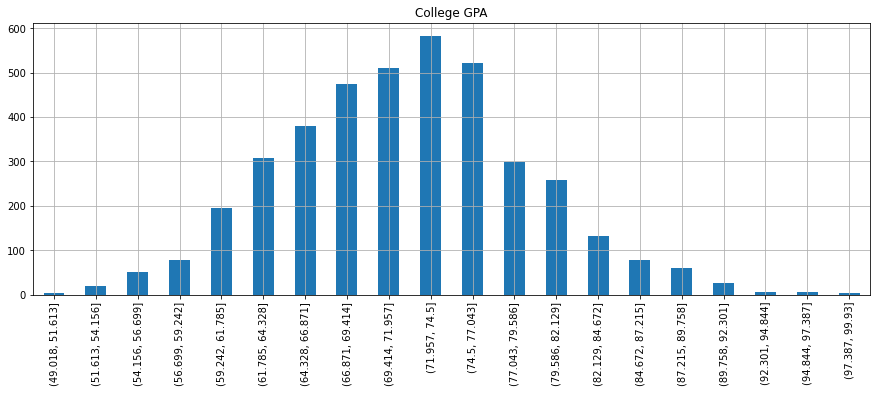

In [36]:

# Distribution of College grades

print('mean markes scored ',df['collegeGPA'].mean())
print('median markes scored',df['collegeGPA'].median())

print()

print('Skewness:',skew(df['collegeGPA']))
print('Kurtosis:',kurtosis(df['collegeGPA']))

print()

plt.figure(figsize=(15,5))
df['collegeGPA'].value_counts(bins=20,sort=False).plot(kind='bar',title='College GPA',grid = True)
plt.show()

mean markes scored  74.46636568284141
median markes scored 74.4

Skewness: -0.032595179202258136
Kurtosis: -0.6314493016154126



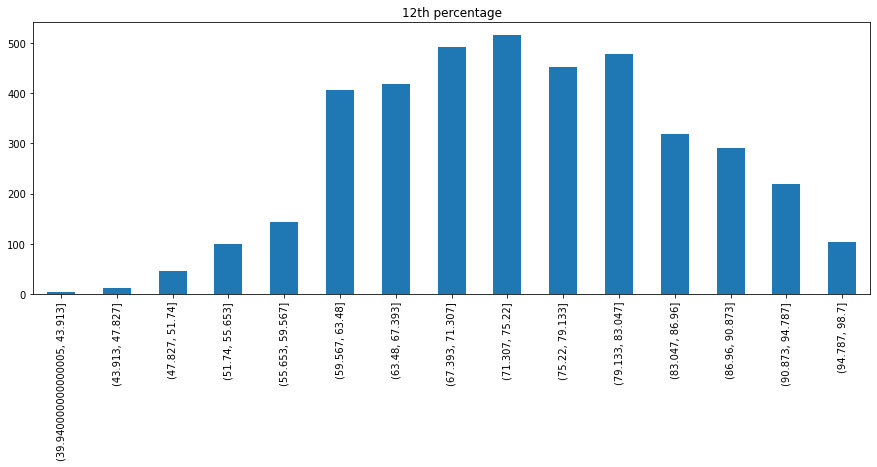

In [37]:

# Distribution of 12th percentage

print('mean markes scored ',df['12percentage'].mean())
print('median markes scored',df['12percentage'].median())

print()

print('Skewness:',skew(df['12percentage']))
print('Kurtosis:',kurtosis(df['12percentage']))

print()

plt.figure(figsize=(15,5))
df['12percentage'].value_counts(bins=15,sort=False).plot(kind='bar',title='12th percentage')
plt.show()

mean markes scored  77.9254427213607
median markes scored 79.15

Skewness: -0.5907967422390255
Kurtosis: -0.11164680905297963



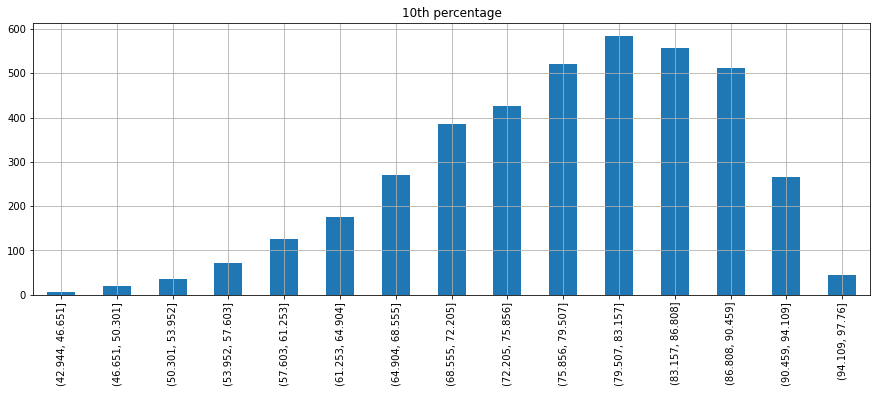

In [38]:
# Distribution of 10th percentage

print('mean markes scored ',df['10percentage'].mean())
print('median markes scored',df['10percentage'].median())
print()
print('Skewness:',skew(df['10percentage']))
print('Kurtosis:',kurtosis(df['10percentage']))
print()
plt.figure(figsize=(15,5))
df['10percentage'].value_counts(bins=15,sort=False).plot(kind='bar',title='10th percentage',grid = True)
plt.show()

mean markes scored  307699.8499249625
median markes scored 300000.0

Skewness: 6.44866054831297
Kurtosis: 80.82731823061802



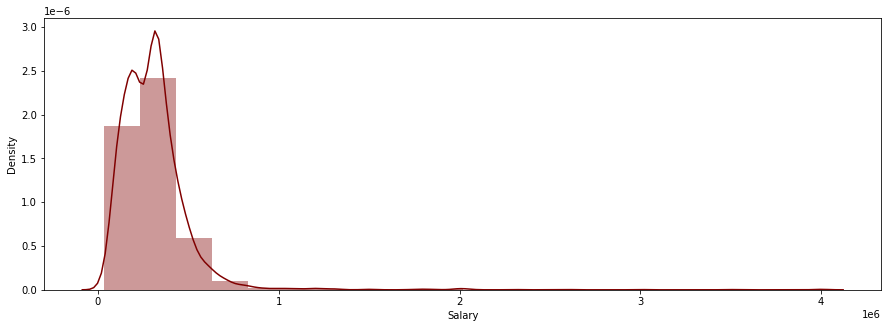

In [39]:

print('mean markes scored ',df['Salary'].mean())
print('median markes scored',df['Salary'].median())

print()

print('Skewness:',skew(df['Salary']))
print('Kurtosis:',kurtosis(df['Salary']))

print()

plt.figure(figsize=(15,5))
sns.distplot(df['Salary'],bins=20, kde=True,hist=True, color='maroon')
plt.show()

<h4>Observation:</h4>
<div>Salary of employees is not normally distributed i.e there is a right skewness in salary as there are outliers exist</div>
<div>The dataset and the kurtosis is very high as mostly employees got there starting package of <strong>Rs 300000</strong>.</div>
</p>

mean markes scored  285447.1586526099
median markes scored 300000.0

Skewness: 0.43205376284764696
Kurtosis: -0.2651888576188304



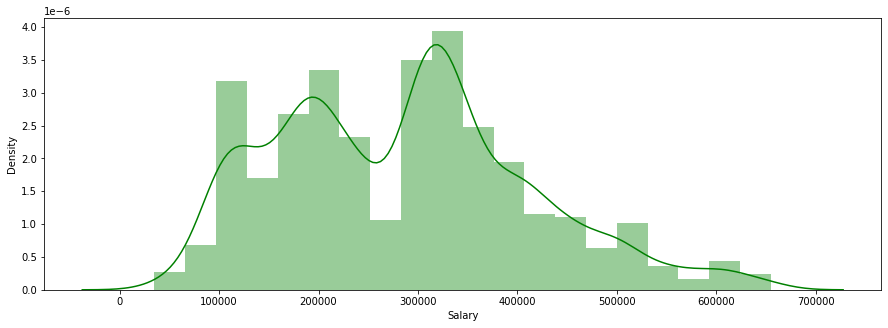

In [40]:
Q1=df['Salary'].quantile(0.25)
Q2=df['Salary'].quantile(0.5)
Q3=df['Salary'].quantile(0.75)
IQR=Q3-Q1
UL=Q3+1.5*IQR
df=df[df['Salary']<=UL]

print('mean markes scored ',df['Salary'].mean())
print('median markes scored',df['Salary'].median())

print()

print('Skewness:',skew(df['Salary']))
print('Kurtosis:',kurtosis(df['Salary']))

print()

plt.figure(figsize=(15,5))
sns.distplot(df['Salary'],bins=20, kde=True,hist=True, color='green')
plt.show()

<h3>Analysing age of candidates vs salary:</h3>

In [41]:
df1=df.copy()

In [42]:
# Analysis only on the bases of years

df1['DOByear']=df1['DOB'].dt.year # Date of birth year
df1.drop(columns=['DOB'],axis=1,inplace=True)
df1=df1[df1['DOByear']>1977]

# Creating new features to calculate the age of candidates after completing graduation.
df1['GradAge']=abs(df1['GraduationYear']-df1['DOByear'])

In [43]:
(df1['GradAge']==1991).value_counts()

False    3887
True        1
Name: GradAge, dtype: int64

In [44]:
df1['GradAge'].unique()

array([  21,   23,   22,   24,   26,   28,   20,   25,   19,   17,   27,
         29, 1991], dtype=int64)

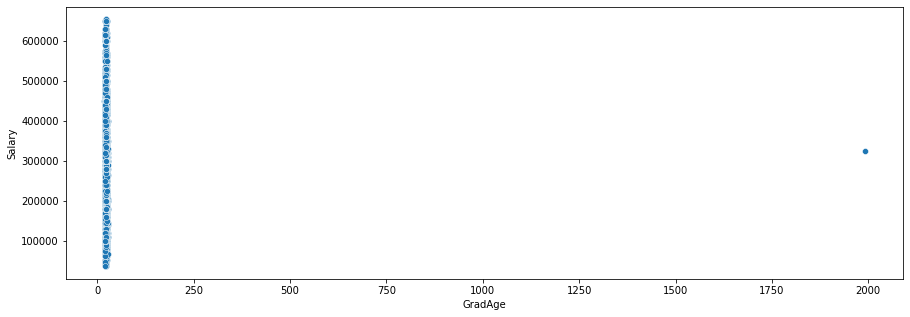

In [45]:
plt.figure(figsize=(15,5))
sns.scatterplot(df1['GradAge'],df1['Salary'])
plt.show()


<h4>Observation:</h4>
<div>There is a missing value in graduation year so i am imputing <strong>median</strong> value of graduation year in that place</div>
</p>

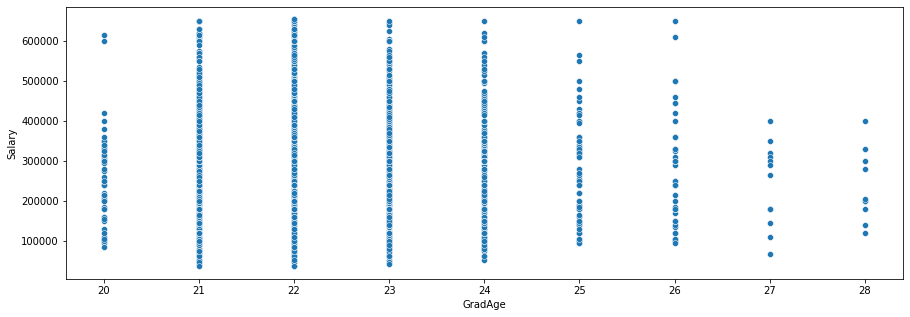

In [46]:
df1['GraduationYear'].replace(to_replace = 0, value = 2013, inplace = True)
df1['GradAge']=abs(df1['GraduationYear']-df1['DOByear'])
df1=(df1[df1['GradAge']>19])
df1= (df1[df1['GradAge']<29])
plt.figure(figsize=(15,5))
sns.scatterplot(df1['GradAge'],df1['Salary'])
plt.show()

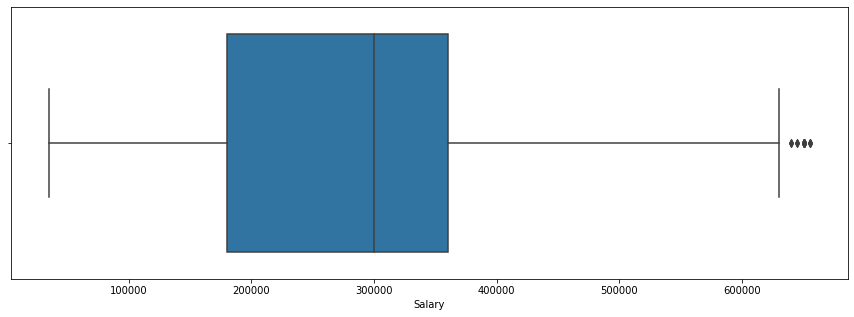

In [47]:
plt.figure(figsize=(15,5))
sns.boxplot(df1['Salary'])
plt.show()

<h2>Data Visualization</h2>
<h3>Univariate Analysis</h3>
<h4>1.Gender Distribution</h4>

Males: 2943
Females: 937
Male to Female Gender Ratio: 3.14



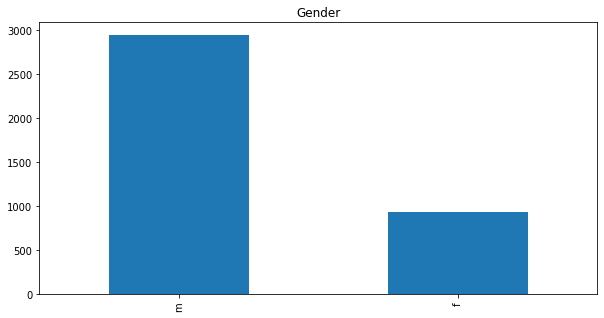

In [48]:
males = df1['Gender'].where(df1['Gender'] == 'm').count()
females = df1['Gender'].where(df1['Gender'] == 'f').count()
print("Males: {}".format(males))
print("Females: {}".format(females))
print("Male to Female Gender Ratio: {:.2f}".format(males / females))
print()
df1['Gender'].value_counts().plot(kind = 'bar', title = 'Gender', figsize = (10, 5))
plt.show()

<p>
<h4>Observation:</h4>
<div>More <strong>male</strong> candidates than <strong>female </strong> candidates.</div>
</p>

<h4>2.Academic scores distribution</h4>
<h5>10th percentage</h5>

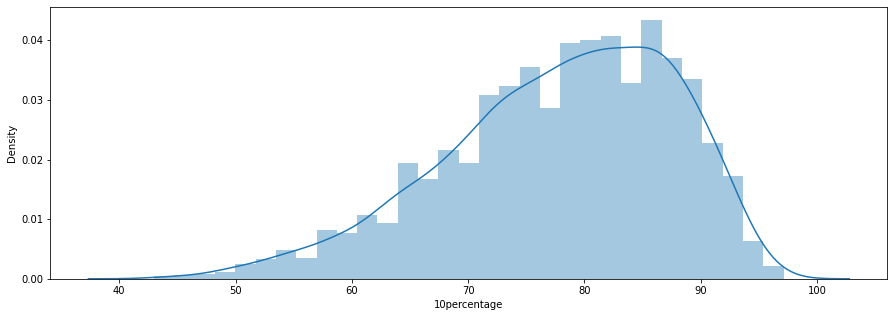

In [49]:
# Distribution of 10th percentage
plt.figure(figsize=(15,5))
sns.distplot(df1['10percentage'])
plt.show()

<p>
<h4>Observation:</h4>
<div> 1. Data is left skewed as some candidates didn't perform well in 10th standerd which impacts average score of all canditates.</div>
<div> i.e reduces the average scores as seen above <strong>mean= 77.92% & Median= 79.15%</strong></div>
<div> 2. Most of the students score around 79% marks</div>
</p>

<h4>12th percentage</h4>

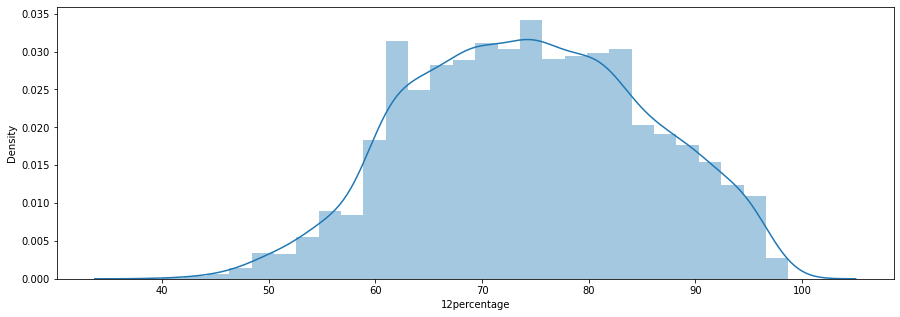

In [50]:
# Distribution of 12th percentage

plt.figure(figsize=(15,5))
sns.distplot(df1['12percentage'])
plt.show()

<p>
<h4>Observation:</h4>
<div>Data is almost normally distributed</div>
</p>

<h4>Collage GPA</h4>

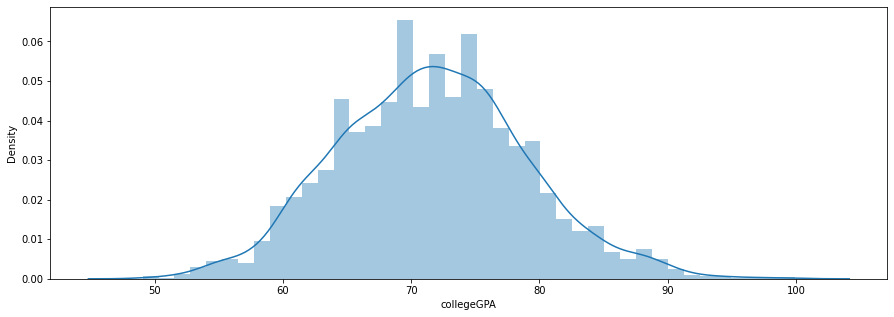

In [51]:

# Distribution of College grades

plt.figure(figsize=(15,5))
sns.distplot(df1['collegeGPA'])
plt.show()

<p>
<h4>Observation:</h4>
<div> 1.  Distribution of college GPA is approximately normal and most of students scored 71.7% in college</div>
</p>

<h3>3. College Tier distribution</h3>

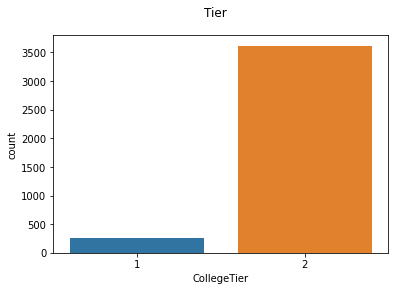

In [52]:
# Distribution of College Tier

sns.countplot(df1['CollegeTier'])
plt.suptitle('Tier')
plt.show()

<p>
<h4>Observation:</h4>
<div> 1.  Students from college Tier 2 are higher in number</div>
</p>

<h3>4. Degree distribution</h3>

<AxesSubplot:>

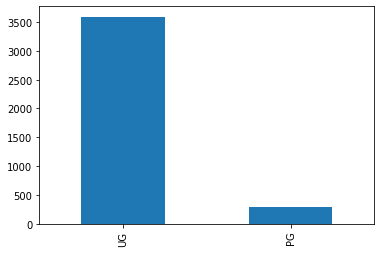

In [53]:
df1['Degree'].value_counts().plot(kind='bar')

<p>
<h4>Observation:</h4>
<div> B.Tech/B.E students are more than any others</div>
</p>

<h3>5. Specialization distribution</h3>

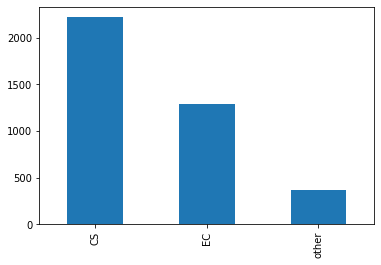

In [54]:

df1['Specialization'].value_counts().plot(kind='bar')
plt.show()

<p>
<h4>Observation:</h4>
<div> Students having specialization in computer science are higher in number.</div>
</p>

<h3>6. 10 board distribution</h3>

state    2238
cbse     1371
icse      271
Name: 10board, dtype: int64



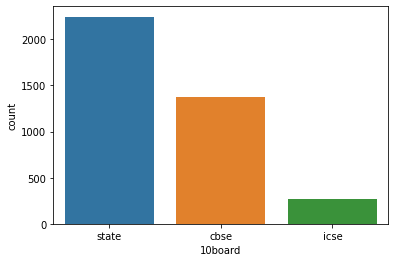

In [55]:
print(df1['10board'].value_counts())

print()

sns.countplot(df['10board'])
plt.show()

<p>
<h4>Observation:</h4>
<div> Most of the class10 students are from state board.</div>
</p>

<h3>7. 12board distribution</h3>

state    2005
cbse     1705
icse      170
Name: 12board, dtype: int64



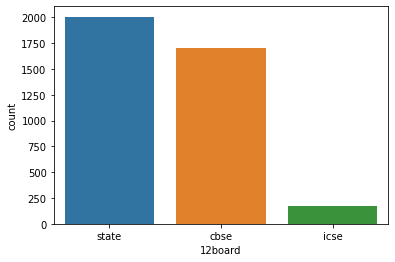

In [56]:

print(df1['12board'].value_counts())

print()

sns.countplot(df1['12board'])
plt.show()

<h2>Features Comparison with Salary</h2>
<h3>Bivariate analysis</h3>
<h4>1. Salary vs Gender</h4>

Gender
f    278388.473853
m    287891.267414
Name: Salary, dtype: float64
Gender
f    300000
m    300000
Name: Salary, dtype: int64



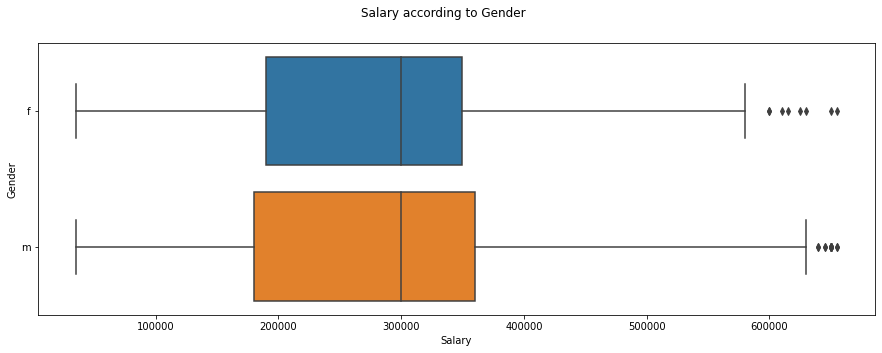

In [57]:

# Does gender affect salaries ?

print(df1.groupby('Gender')['Salary'].mean())
print(df1.groupby('Gender')['Salary'].median())

print()
plt.figure(figsize=(15,5))
sns.boxplot(x='Salary', y = 'Gender', data=df1)
plt.suptitle('Salary according to Gender')
plt.show()

<p>
<h4>Observation:</h4>
<div> 1 Mean salary of males is slightly greater than females salary.</div>
<div> 2 Median salary earned by both the genders are equal</div>
</p>

<h4>2. Salary vs college state</h4>

CollegeState
North_Zone.    276248.356465
Other_Zone     290212.591987
South_Zone.    291149.068323
Name: Salary, dtype: float64



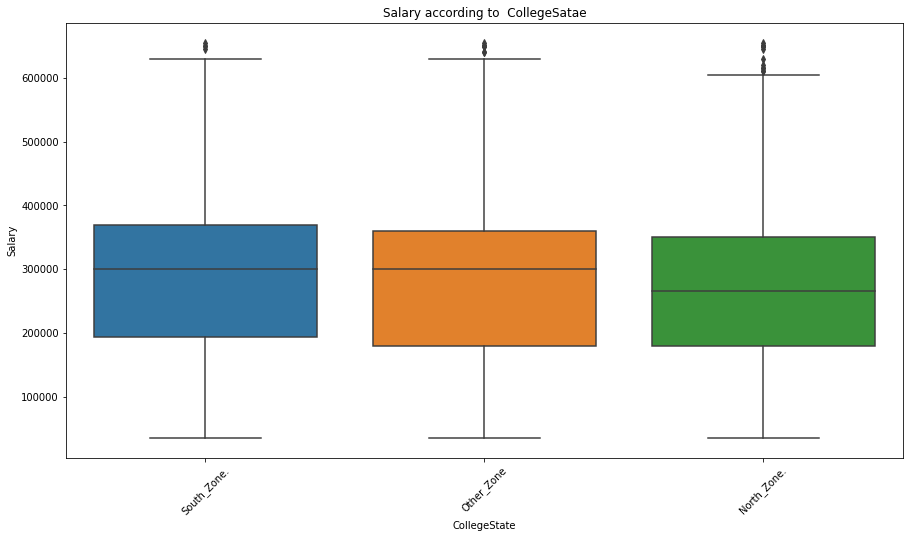

In [58]:
# Does loaction of college affect salaries of Candidates?

print(df1.groupby('CollegeState')['Salary'].mean())
print()
plt.figure(figsize = (15, 8))
plt.xticks(rotation = 45)
sns.boxplot(x = 'CollegeState', y = 'Salary', data = df1)
plt.title('Salary according to  CollegeSatae')
plt.show()

<p>
<h4>Zones:</h4>
<div> Jammu and Kashmir, Himachal Pradesh, Punjab, Uttarakhand , Uttar Pradesh and Haryana.</div>
<div> <strong>East Zone:</strong> the east zone is comprised of states of Bihar, Orissa, Jharkhand, and West Bengal.</div>
<div> <strong>West Zone:</strong> This zone has the states of Rajasthan , Gujarat, Goa and Maharashtra
South Zone: States of Andhra Pradesh, Karnataka, Kerala and Tamil Nadu</div>
<div> <strong>Central Zone:</strong> Madhya Pradesh and Chhattisgarh</div>
</p>

<p>
<h4>Observation:</h4>
<div> There is huge affect of college loaction on salaries of Candidates as it clearly visible above some college candidates.</div>
<div> Hired at good package and some are getting very low package.</div>
<div>Median salary of students from Meghalaya and Jammu&Kashmir is higher.</div>
</p>

<h4>3. Salary vs Degree</h4>

Degree
PG    253732.394366
UG    288112.903226
Name: Salary, dtype: float64



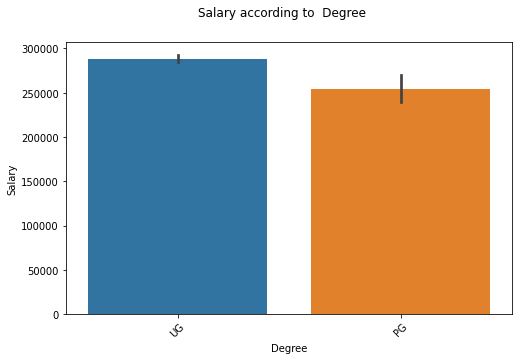

In [59]:
# Does degree awarded affect salaries of Candidates?

print(df1.groupby('Degree')['Salary'].mean())

print()

plt.figure(figsize = (8, 5))
plt.xticks(rotation = 45)
sns.barplot(x = 'Degree', y = 'Salary', data = df1)
plt.suptitle('Salary according to  Degree')
plt.show()

<p>
<h4>Observation:</h4>
<div> There is not much difference in median salary earned by different degree holders but it's clearly visible that UG degree Candidates</div>
<div> Are getting huge packages as compare to other PG degree candidates.</div>
</p>

<h4>4. Salary vs Specialization</h4>

Specialization
CS       288775.326430
EC       282623.839009
other    276822.888283
Name: Salary, dtype: float64



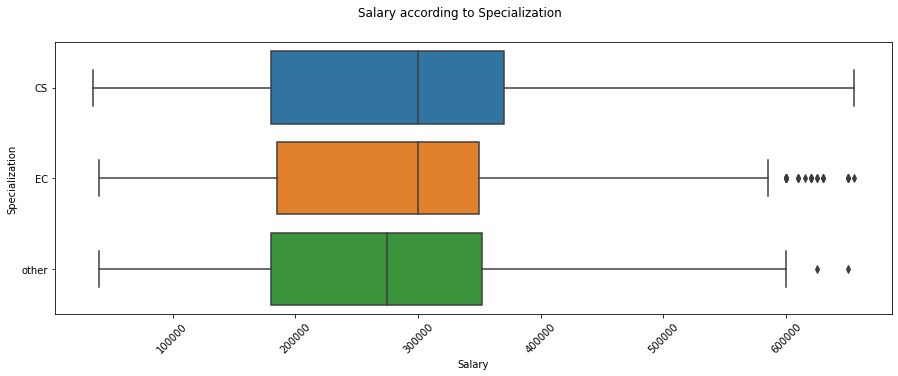

In [60]:
# Does specialization affect salary ?

print(df1.groupby('Specialization')['Salary'].mean())

print()

plt.figure(figsize=(15,5))
plt.xticks(rotation = 45)
sns.boxplot(x='Salary', y = 'Specialization', data=df1)
plt.suptitle('Salary according to Specialization')
plt.show()

<p>
<h4>Observation:</h4>
<div> The mean salary of other depts is higher than salary of candidates having specialization in CS and EC.</div>
</p>

<h4>5. Salary vs CollegeTier</h4>

CollegeTier
1    368288.973384
2    279583.632845
Name: Salary, dtype: float64



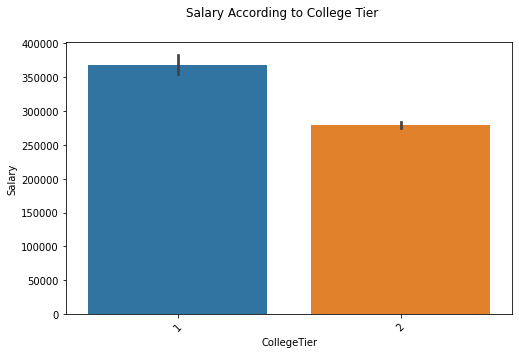

In [61]:
print(df1.groupby('CollegeTier')['Salary'].mean())

print()

plt.figure(figsize=(8,5))
plt.xticks(rotation = 45)
sns.barplot(x = 'CollegeTier',y='Salary',data=df1)
plt.suptitle('Salary According to College Tier')
plt.show()

<p>
<h4>Observation:</h4>
<div> Salary of students from Tier1 college is high.</div>
</p>

<h4>6. Salary vs 10 board</h4>

10board
cbse     295342.815463
icse     306107.011070
state    277142.091153
Name: Salary, dtype: float64



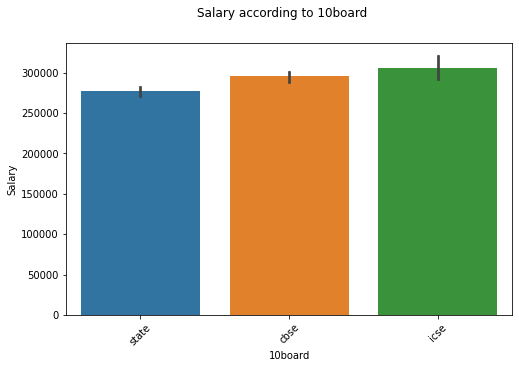

In [62]:

print(df1.groupby('10board')['Salary'].mean())

print()

plt.figure(figsize=(8,5))
plt.xticks(rotation = 45)
sns.barplot(x = '10board',y='Salary',data=df1)
plt.suptitle('Salary according to 10board')
plt.show()

<p>
<h4>Observation:</h4>
<div> Salary of 10board students having board other than state,cbse,icse boards is higher.</div>
</p>

<h4>7. Salary vs 12 board</h4>

12board
cbse     304891.495601
icse     316029.411765
state    266607.980050
Name: Salary, dtype: float64



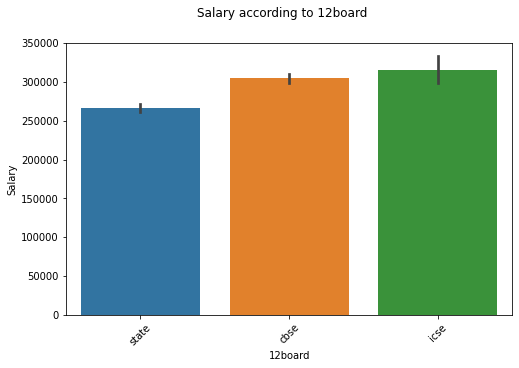

In [63]:
print(df1.groupby('12board')['Salary'].mean())

print()

plt.figure(figsize=(8,5))
plt.xticks(rotation = 45)
sns.barplot(x = '12board',y='Salary',data=df1)
plt.suptitle('Salary according to 12board')
plt.show()

<p>
<h4>Observation:</h4>
<div> Salary of 12board students having board other than state,cbse,icse boards is higher.</div>
</p>

<h4>8. Salary vs gradage</h4>

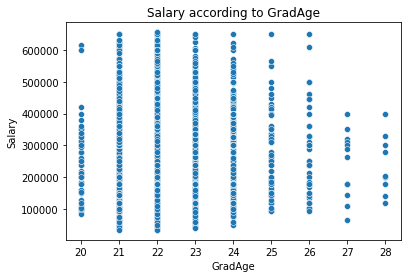

In [64]:
sns.scatterplot(df1['GradAge'],df1['Salary'])
plt.title('Salary according to GradAge')
plt.show()

<p>
<h4>Observation:</h4>
<div> High salary is of students having age 23.</div>
</p>

<h3>Correlation</h3>

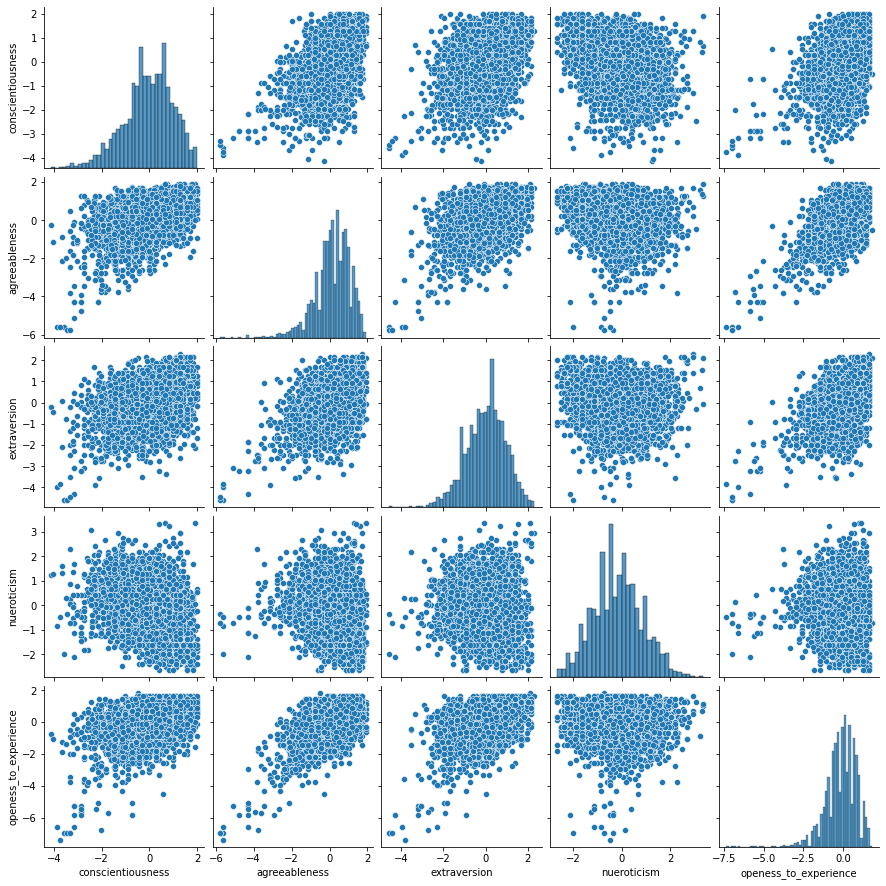

In [65]:
personality_scores=['conscientiousness', 'agreeableness', 'extraversion', 'nueroticism', 'openess_to_experience']


sns.pairplot(df1, vars = personality_scores)
plt.show()

<h3>Correlation of personality scores</h3>

<AxesSubplot:>

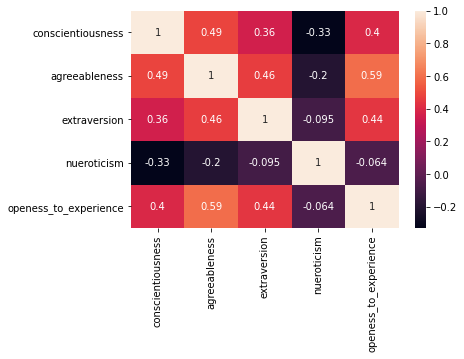

In [66]:
personality = df[['conscientiousness',
                'agreeableness',
                'extraversion',
                'nueroticism',
                'openess_to_experience']]
corrMatrix2 = personality.corr()
sns.heatmap(corrMatrix2, annot=True)

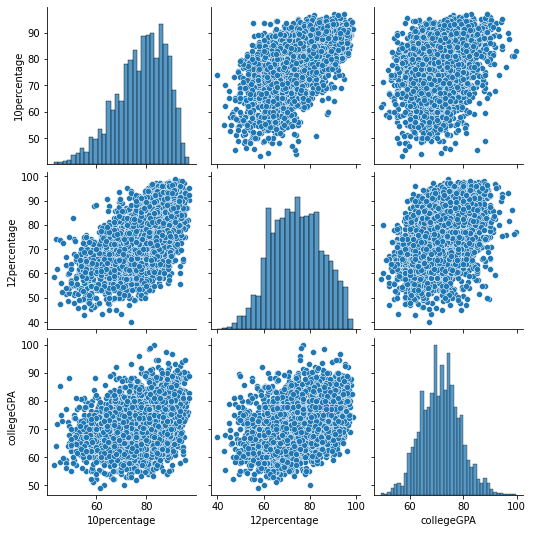

In [67]:
#Correlation of Academic scores

academic_performance = ['10percentage', '12percentage', 'collegeGPA']

sns.pairplot(df1, vars = academic_performance)
plt.show()

<h4>Correlation of 10th percentage , 12th percentage , college GPA and Salary</h4>


<AxesSubplot:>

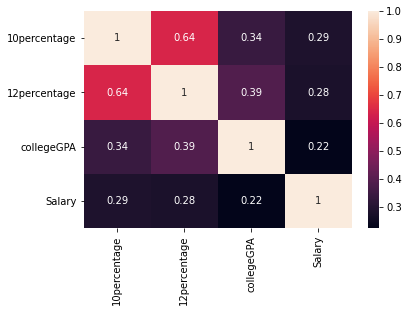

In [68]:
d = df[['10percentage',
                   '12percentage',
                   'collegeGPA','Salary']]
corrMatrix1 = d.corr()
sns.heatmap(corrMatrix1, annot=True)

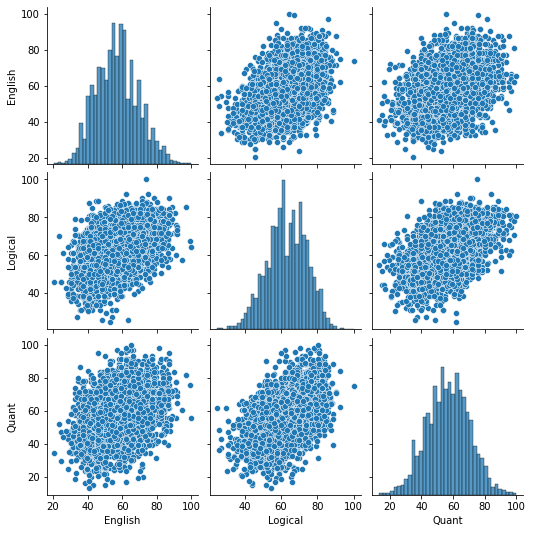

In [69]:

# Correlation of Standard Test Scores

std_test_scores = ['English', 'Logical', 'Quant']
sns.pairplot(df1, vars = std_test_scores)
plt.show()

<h3>Correlation of Standared Test Scores</h3>

<AxesSubplot:>

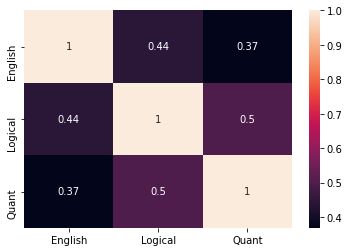

In [70]:
std_test = df[['English',
                   'Logical',
                   'Quant']]
corrMatrix3 = std_test.corr()
sns.heatmap(corrMatrix3, annot=True)

In [71]:
# correlation b/w salary and all numerical feature

df1.drop(['Gender', 'CollegeTier', 'Degree', 'Specialization', 'CollegeState'],axis=1).corr()['Salary']

Salary                   1.000000
10percentage             0.283515
12graduation            -0.154027
12percentage             0.279273
collegeGPA               0.223640
CollegeCityTier          0.034020
GraduationYear          -0.244569
English                  0.252530
Logical                  0.248465
Quant                    0.346894
Domain                   0.157738
ComputerProgramming      0.165088
ElectronicsAndSemicon    0.026258
ComputerScience         -0.134262
MechanicalEngg           0.003966
ElectricalEngg          -0.049185
TelecomEngg             -0.006664
CivilEngg                0.029782
conscientiousness       -0.056761
agreeableness            0.061764
extraversion            -0.032366
nueroticism             -0.053962
openess_to_experience   -0.009467
Experience               0.480871
Cognitive Test Scores    0.362473
DOByear                 -0.144791
GradAge                 -0.058927
Name: Salary, dtype: float64

In [73]:
df1.dtypes

Salary                             int64
DOJ                       datetime64[ns]
DOL                       datetime64[ns]
Designation                       object
JobCity                           object
Gender                            object
10percentage                     float64
10board                           object
12graduation                       int64
12percentage                     float64
12board                           object
CollegeTier                        int64
Degree                            object
Specialization                    object
collegeGPA                       float64
CollegeCityTier                    int64
CollegeState                      object
GraduationYear                     int64
English                          float64
Logical                          float64
Quant                            float64
Domain                           float64
ComputerProgramming                int64
ElectronicsAndSemicon              int64
ComputerScience 

<h3>Creating Dummy data for categorical variables</h3>

In [74]:
categorical_features= ['Specialization', 'CollegeState', 'Gender', 'Degree','12board','10board','CollegeTier','CollegeCityTier']


for i in categorical_features:
    unique = len(df1[i].unique())
    print("{}: {}".format(i, unique))

Specialization: 3
CollegeState: 3
Gender: 2
Degree: 2
12board: 3
10board: 3
CollegeTier: 2
CollegeCityTier: 2


In [83]:
df2 = pd.get_dummies(df1, columns = categorical_features )

In [84]:
df1.shape

(3880, 41)

In [85]:
df2.shape

(3880, 53)

In [86]:
df2.columns

Index(['Salary', 'DOJ', 'DOL', 'Designation', 'JobCity', '10percentage',
       '12graduation', '12percentage', 'collegeGPA', 'GraduationYear',
       'English', 'Logical', 'Quant', 'Domain', 'ComputerProgramming',
       'ElectronicsAndSemicon', 'ComputerScience', 'MechanicalEngg',
       'ElectricalEngg', 'TelecomEngg', 'CivilEngg', 'conscientiousness',
       'agreeableness', 'extraversion', 'nueroticism', 'openess_to_experience',
       'EXP', 'Age', 'Experience', 'Designations', 'Cognitive Test Scores',
       'DOByear', 'GradAge', 'Specialization_CS', 'Specialization_EC',
       'Specialization_other', 'CollegeState_North_Zone.',
       'CollegeState_Other_Zone', 'CollegeState_South_Zone.', 'Gender_f',
       'Gender_m', 'Degree_PG', 'Degree_UG', '12board_cbse', '12board_icse',
       '12board_state', '10board_cbse', '10board_icse', '10board_state',
       'CollegeTier_1', 'CollegeTier_2', 'CollegeCityTier_0',
       'CollegeCityTier_1'],
      dtype='object')

In [87]:
df2.drop(['DOJ', 'DOL','Designation', 'JobCity','collegeGPA', 'GraduationYear',
       'English', 'Logical', 'Domain','EXP', 'Age', 'Experience', 'Cognitive Test Scores',
       'DOByear', 'GradAge'], axis=1, inplace=True)

In [88]:
df2.shape

(3880, 38)

In [89]:
df2.columns

Index(['Salary', '10percentage', '12graduation', '12percentage', 'Quant',
       'ComputerProgramming', 'ElectronicsAndSemicon', 'ComputerScience',
       'MechanicalEngg', 'ElectricalEngg', 'TelecomEngg', 'CivilEngg',
       'conscientiousness', 'agreeableness', 'extraversion', 'nueroticism',
       'openess_to_experience', 'Designations', 'Specialization_CS',
       'Specialization_EC', 'Specialization_other', 'CollegeState_North_Zone.',
       'CollegeState_Other_Zone', 'CollegeState_South_Zone.', 'Gender_f',
       'Gender_m', 'Degree_PG', 'Degree_UG', '12board_cbse', '12board_icse',
       '12board_state', '10board_cbse', '10board_icse', '10board_state',
       'CollegeTier_1', 'CollegeTier_2', 'CollegeCityTier_0',
       'CollegeCityTier_1'],
      dtype='object')

In [92]:
df2['Designations'].nunique()

11

1    2149
2    1731
Name: Salary, dtype: int64


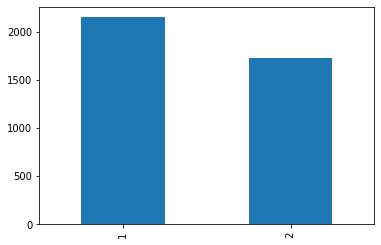

In [93]:
#Creating 2 buckets for salary as salary above average and below average.

salary_cat = pd.qcut(df2['Salary'], [0, .5, 1],labels=[1,2])
print(salary_cat.value_counts())
salary_cat.value_counts().plot(kind = 'bar')
plt.show()

<h3>df2 is the cleaned data and it is ready to use for modelling . Dependents variable is salary</h3>